In [31]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
#Preprocessing 
import re
import nltk
import missingno as msno
from skmultilearn.model_selection import iterative_train_test_split

pd.set_option('display.max_rows', 100)


In [32]:
df = pd.read_csv('QueryResults2.csv')
display(df[:5])
print("Shape of Df:",  df.shape)

,Title,Body,Tags,Id,Score,ViewCount,AnswerCount
0,"Android Jetpack Navigation, BottomNavigationVi...","<p>Android Jetpack Navigation, BottomNavigatio...",<android><android-architecture-components><bot...,50577356,81,67388,14
1,JetPack Compose Button with drawable,<p>How can we achieve this in jetpack compose<...,<android><android-jetpack-compose><android-com...,72336943,10,17903,6
2,How to handle back button when at the starting...,<p>I've started working with the new navigatio...,<android-architecture-components><android-arch...,50937116,17,23616,8
3,TopAppBar flashing when navigating with Compos...,<p>I have 2 screens which both have their own ...,<android><android-jetpack><android-jetpack-com...,68633717,19,4757,9
4,How to create recycler view in Compose Jetpack?,<p>Is there any special way to create recycler...,<android><android-recyclerview><android-jetpac...,58691725,17,12553,7


Shape of Df: (50000, 7)


<Axes: >

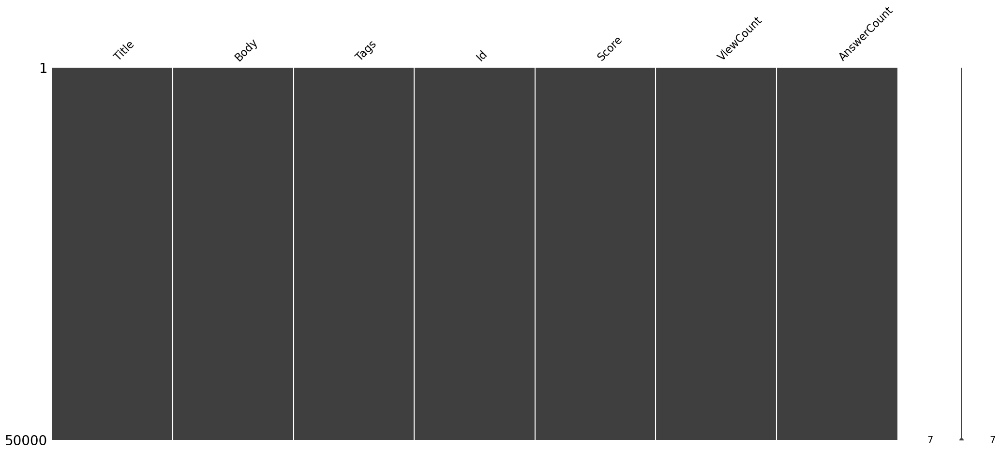

In [33]:
msno.matrix(df)

## Preprocessing Steps:
We will use Pipelines fort the preprocessing steps.  
The first steps of preprocessing will involve cleaning the 'Body' column by removing HTML tags and special characters. After that, we will tokenize the cells.

Here are the steps in detail:
1. Clean the 'Body' column by removing HTML tags and special characters.
2. Tokenize the cells.

Please note that these steps are crucial for preparing the data for further analysis or modeling.

### Body Preprocessing

In [34]:
body = []
body= df.iloc[:].Body
print(body)

0        <p>Android Jetpack Navigation, BottomNavigatio...
1        <p>How can we achieve this in jetpack compose<...
2        <p>I've started working with the new navigatio...
3        <p>I have 2 screens which both have their own ...
4        <p>Is there any special way to create recycler...
                               ...                        
49995    <p>I am trying to POST to <a href="http://loca...
49996    <p>I want my form submit button to be disabled...
49997    <p>Consider a Console application that starts ...
49998    <p>I have a code for adding the texts to exist...
49999    <p>Our maven build throws at the end of the bu...
Name: Body, Length: 50000, dtype: object


In [35]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from bs4 import BeautifulSoup
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')


class TagsCleaner(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        return [self.clean_tags(text) for text in X]

    def clean_tags(self, text):
        tags_to_transform = BeautifulSoup(text, "html.parser")
        return [tag.name for tag in tags_to_transform.find_all()]
    
    
class HtmlCleaner(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        return [self.clean_text(text) for text in X]

    def clean_text(self, text):
    # Delete HTML tags
        clean_text = re.sub(r'<.*?>', '', text)
    # Delete special characters and punctuation
        clean_text = re.sub(r'[^a-zA-Z\s]', '', clean_text)
        return clean_text
    

class TextTokenizer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        return [nltk.word_tokenize(text) for text in X]

class TextLower(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        return [[word.lower() for word in text] for text in X]
    
class TextStopWordRemover(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        stop_words = set(nltk.corpus.stopwords.words('english'))
        additional_stopwords = {"im", "ive",'new','like','get','want','would','need','use','using','used','one','two','three','four','five','six','seven','eight','nine','ten',
                                'public','like', 'doesnt','try','thanks',
                                'microsoftextensionsdependencyinjectionactivatorutilitiesgetserviceorcreateinstanceiserviceprovider',
                                'uscentraldockerpkgdevprojectidreponamev','use','gt','orgopenqaseleniuminteractionsactionsbuiltactionperformactionsjava',
                                'pageobjectsactivitypageobjectclickaudioinlinestopinactivitypageobjectjava','stepdefinitionactivitytheaudioplayeroftheelementisstoppedinactivityjava'}
        stop_words.update(additional_stopwords)
        return [[word for word in text if word not in stop_words] for text in X]
    
class TextLemmatizer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.lemmatizer = WordNetLemmatizer()

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        return [[self.lemmatize(word) for word in text] for text in X]

    def lemmatize(self, word):
        pos_tag = self.get_wordnet_pos(word)
        if pos_tag:
            return self.lemmatizer.lemmatize(word, pos=pos_tag)
        else:
            return word

    def get_wordnet_pos(self, word):
        """Map POS tag to first character used by WordNetLemmatizer"""
        tag = nltk.pos_tag([word])[0][1][0].upper()
        tag_dict = {"J": wordnet.ADJ,
                    "N": wordnet.NOUN,
                    "V": wordnet.VERB,
                    "R": wordnet.ADV}

        return tag_dict.get(tag, wordnet.NOUN)
    
pipeline = Pipeline([
    ('html_cleaner', HtmlCleaner()),
    ('tokenizer', TextTokenizer()),
    ('stop_words', TextStopWordRemover()),
    ('text_lower', TextLower()),
    ('tags_cleaner', TagsCleaner()),
    ('lemmatizer',TextLemmatizer())
])

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/aqlice/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /Users/aqlice/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/aqlice/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /Users/aqlice/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [36]:
preprocessed_body = pipeline.named_steps['html_cleaner'].transform(body)
print('ok0')
preprocessed_body = pipeline.named_steps['tokenizer'].transform(preprocessed_body)
print('ok1')
preprocessed_body = pipeline.named_steps['text_lower'].transform(preprocessed_body)
print('ok2')
preprocessed_body = pipeline.named_steps['lemmatizer'].transform(preprocessed_body)
print('ok3')
print(preprocessed_body[0])




ok0
ok1
ok2
ok3
['android', 'jetpack', 'navigation', 'bottomnavigationview', 'with', 'auto', 'fragment', 'back', 'stack', 'on', 'back', 'button', 'click', 'what', 'i', 'want', 'after', 'choose', 'multiple', 'tab', 'one', 'after', 'another', 'by', 'user', 'and', 'user', 'click', 'on', 'back', 'button', 'app', 'must', 'redirect', 'to', 'the', 'last', 'page', 'heshe', 'open', 'i', 'achieve', 'the', 'same', 'use', 'android', 'viewpager', 'by', 'save', 'the', 'currently', 'select', 'item', 'in', 'an', 'arraylist', 'be', 'there', 'any', 'auto', 'back', 'stack', 'after', 'android', 'jetpack', 'navigation', 'release', 'i', 'want', 'to', 'achieve', 'it', 'use', 'navigation', 'graph', 'activitymainxml', 'ltxml', 'version', 'encodingutfgt', 'ltandroidsupportconstraintconstraintlayout', 'xmlnsandroidhttpschemasandroidcomapkresandroid', 'xmlnsapphttpschemasandroidcomapkresauto', 'xmlnstoolshttpschemasandroidcomtools', 'androidididcontainer', 'androidlayoutwidthmatchparent', 'androidlayoutheightmatc

In [37]:
# frequence des tokens
from collections import defaultdict
def calculate_token_frequency(body):
    token_frequency = defaultdict(int)
    for text in body:
        for token in text:
            token_frequency[token] += 1
    sorted_token_frequency = dict(sorted(token_frequency.items(), key=lambda x: x[1], reverse=True))
    return sorted_token_frequency

token_frequency = calculate_token_frequency(preprocessed_body)
print(list(token_frequency.items())[:10])


[('the', 295274), ('be', 223041), ('i', 200158), ('to', 196209), ('a', 172064), ('and', 105742), ('in', 101651), ('it', 82890), ('of', 81845), ('this', 75569)]


Les mots que l'on retrouve le plus sont des stopword.

In [38]:
preprocessed_body = pipeline.named_steps['stop_words'].transform(preprocessed_body)
print(preprocessed_body[0])

['android', 'jetpack', 'navigation', 'bottomnavigationview', 'auto', 'fragment', 'back', 'stack', 'back', 'button', 'click', 'choose', 'multiple', 'tab', 'another', 'user', 'user', 'click', 'back', 'button', 'app', 'must', 'redirect', 'last', 'page', 'heshe', 'open', 'achieve', 'android', 'viewpager', 'save', 'currently', 'select', 'item', 'arraylist', 'auto', 'back', 'stack', 'android', 'jetpack', 'navigation', 'release', 'achieve', 'navigation', 'graph', 'activitymainxml', 'ltxml', 'version', 'encodingutfgt', 'ltandroidsupportconstraintconstraintlayout', 'xmlnsandroidhttpschemasandroidcomapkresandroid', 'xmlnsapphttpschemasandroidcomapkresauto', 'xmlnstoolshttpschemasandroidcomtools', 'androidididcontainer', 'androidlayoutwidthmatchparent', 'androidlayoutheightmatchparent', 'toolscontextmainmainactivitygt', 'ltfragment', 'androidididmynavhostfragment', 'androidnameandroidxnavigationfragmentnavhostfragment', 'androidlayoutwidthmatchparent', 'androidlayoutheightdp', 'appdefaultnavhostt

In [39]:

token_body_frequency = calculate_token_frequency(preprocessed_body)
print(token_body_frequency)
import matplotlib.pyplot as plt

# Get the top 50 words and their frequencies
top_50_words = list(token_body_frequency.keys())[:50]
top_50_frequencies = list(token_body_frequency.values())[:50]

{'error': 26497, 'code': 25129, 'file': 24569, 'work': 24097, 'return': 20757, 'class': 20110, 'run': 16344, 'way': 14944, 'function': 14481, 'string': 14271, 'set': 13569, 'follow': 13462, 'import': 13242, 'user': 13234, 'create': 13124, 'value': 13105, 'problem': 13008, 'method': 12627, 'data': 12315, 'name': 11998, 'make': 11836, 'add': 11552, 'app': 11317, 'know': 11291, 'project': 11102, 'test': 11059, 'id': 10950, 'call': 10909, 'int': 10769, 'application': 10760, 'time': 10566, 'version': 10335, 'also': 10304, 'see': 10026, 'change': 9985, 'object': 9970, 'void': 9968, 'c': 9595, 'type': 9509, 'look': 9426, 'example': 9228, 'view': 9147, 'dont': 9064, 'server': 9027, 'line': 9004, 'could': 8880, 'var': 8800, 'question': 8722, 'update': 8632, 'null': 8527, 'x': 8436, 'seem': 8358, 'find': 8265, 'something': 7938, 'solution': 7788, 'true': 7779, 'page': 7672, 'start': 7670, 'help': 7473, 'image': 7317, 'show': 7297, 'private': 7264, 'found': 7243, 'list': 7116, 'result': 7103, 'go

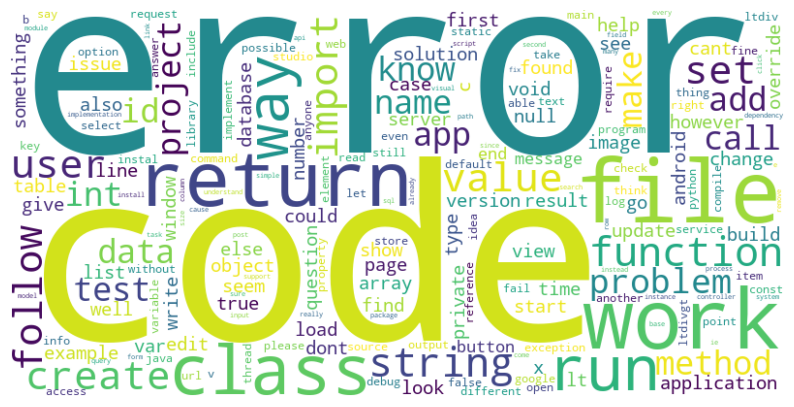

In [40]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
# Créer l'objet WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white')

# Générer le nuage de mots à partir du dictionnaire de fréquences
wordcloud.generate_from_frequencies(token_body_frequency)

# Afficher le nuage de mots
plt.figure(figsize=(10, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

### Title preprocessing

In [41]:
title = df.iloc[:].Title

preprocessed_title = pipeline.named_steps['html_cleaner'].transform(title)
preprocessed_title = pipeline.named_steps['tokenizer'].transform(preprocessed_title)
preprocessed_title = pipeline.named_steps['stop_words'].transform(preprocessed_title)
preprocessed_title = pipeline.named_steps['text_lower'].transform(preprocessed_title)
preprocessed_title = pipeline.named_steps['lemmatizer'].transform(preprocessed_title)
print(preprocessed_title)

[['android', 'jetpack', 'navigation', 'bottomnavigationview', 'youtube', 'instagram', 'proper', 'back', 'navigation', 'fragment', 'back', 'stack'], ['jetpack', 'compose', 'button', 'drawable'], ['how', 'handle', 'back', 'button', 'start', 'destination', 'navigation', 'component'], ['topappbar', 'flash', 'navigate', 'compose', 'navigation'], ['how', 'create', 'recycler', 'view', 'compose', 'jetpack'], ['jetpackcompose', 'navigation', 'nest', 'graph', 'cause', 'viewmodelstore', 'set', 'setgraph', 'call', 'exception'], ['how', 'navhostfragment'], ['how', 'align', 'title', 'layout', 'center', 'topappbar'], ['jetpack', 'compose', 'lazycolumn', 'programmatically', 'scroll', 'item'], ['collapse', 'appbarlayout', 'scroll', 'tablayout', 'nestedscrollview'], ['google', 'map', 'android', 'api', 'authorization', 'failure', 'ensure', 'google', 'map', 'android', 'api', 'v', 'enable', 'ensure', 'follow', 'android', 'key', 'exists'], ['visual', 'studio', 'suddenly', 'debug', 'test'], ['why', 'android'

In [42]:
# Title tokens frequency
token_title_frequency = calculate_token_frequency(preprocessed_title)
print(token_title_frequency)


# Get the top 50 words and their frequencies
top_50_words = list(token_title_frequency.keys())[:50]
top_50_frequencies = list(token_title_frequency.values())[:50]

{'how': 10228, 'i': 3412, 'error': 2842, 'android': 2680, 'file': 2094, 'c': 1861, 'what': 1605, 'be': 1578, 'java': 1509, 'work': 1493, 'studio': 1492, 'value': 1343, 'python': 1307, 'function': 1256, 'code': 1242, 'javascript': 1233, 'v': 1232, 'why': 1226, 'array': 1211, 'string': 1185, 'object': 1164, 'change': 1134, 'server': 1109, 'set': 1086, 'data': 1073, 'way': 1041, 'class': 1035, 'app': 1035, 'sql': 1018, 'create': 994, 'test': 993, 'visual': 979, 'window': 979, 'find': 967, 'add': 960, 'can': 953, 'run': 942, 'google': 928, 'application': 912, 'method': 895, 'database': 880, 'image': 879, 'list': 858, 'type': 856, 'get': 850, 'name': 848, 'fail': 809, 'variable': 779, 'view': 777, 'load': 772, 'io': 766, 'jquery': 761, 'call': 753, 'multiple': 750, 'make': 749, 'without': 742, 'aspnet': 740, 'project': 738, 'text': 719, 'return': 701, 'web': 694, 'button': 687, 'user': 675, 'bootstrap': 672, 'number': 667, 'element': 667, 'table': 656, 'show': 654, 'key': 645, 'api': 640, '

### Tags Preprocessing

In [43]:

tags = df.iloc[:].Tags
#print(tags)
preprocessed_tags = pipeline.named_steps['tags_cleaner'].transform(tags)
print(preprocessed_tags)

[['android', 'android-architecture-components', 'bottomnavigationview', 'android-navigation', 'android-architecture-navigation'], ['android', 'android-jetpack-compose', 'android-compose-textfield', 'android-compose-button', 'android-jetpack-compose-button'], ['android-architecture-components', 'android-architecture-navigation', 'android-navigation', 'android-jetpack-navigation'], ['android', 'android-jetpack', 'android-jetpack-compose', 'android-jetpack-navigation', 'android-jetpack-compose-scaffold'], ['android', 'android-recyclerview', 'android-jetpack-compose', 'android-jetpack-compose-list', 'android-compose-lazyfor'], ['kotlin', 'android-jetpack-compose', 'android-jetpack', 'android-architecture-navigation', 'jetpack-compose-navigation'], ['android', 'android-fragments', 'android-architecture-components', 'fragmentmanager', 'android-architecture-navigation'], ['android', 'android-jetpack-compose', 'android-jetpack', 'android-jetpack-compose-material3', 'android-compose-appbar'], [

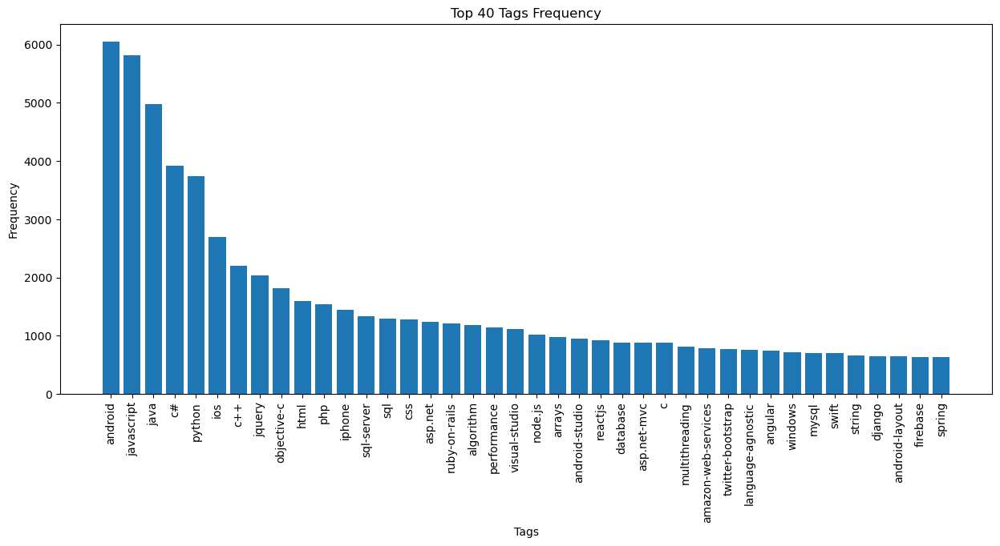

In [44]:
# Tags frequency
tags_frequency = calculate_token_frequency(preprocessed_tags)

# Get the top 10 tags and their frequencies
top_40_tags = list(tags_frequency.keys())[:40]
top_40_frequencies = list(tags_frequency.values())[:40]

# Plot the tags frequency
plt.figure(figsize=(15, 6))
plt.bar(top_40_tags, top_40_frequencies)
plt.xlabel('Tags')
plt.ylabel('Frequency')
plt.title('Top 40 Tags Frequency')
plt.xticks(rotation=90)
plt.show()


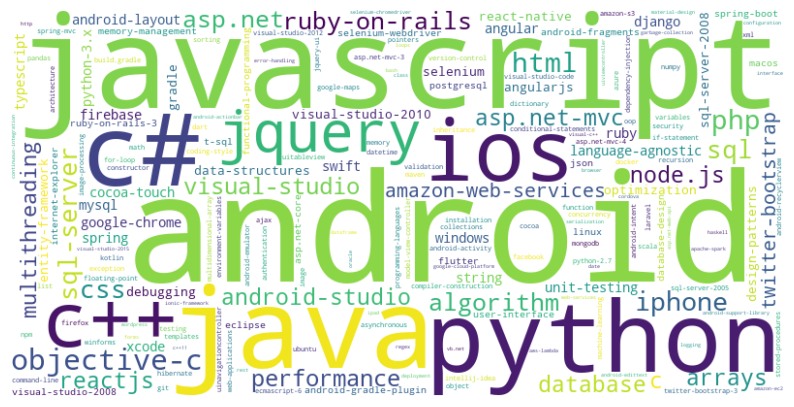

In [45]:
# Créer l'objet WordCloud
wordcloud = WordCloud(width=800, height=400, background_color='white')

# Générer le nuage de mots à partir du dictionnaire de fréquences
wordcloud.generate_from_frequencies(tags_frequency)

# Afficher le nuage de mots
plt.figure(figsize=(10, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [46]:

lonely_tags = [tag for tag, frequency in tags_frequency.items() if frequency == 1]
print("Lonely tags: ",len(lonely_tags))
print("Total_tags:", len(tags_frequency))

Lonely tags:  6264
Total_tags: 15546


In [47]:
# For each sublist, join its elements into a single string
preprocessed_body = [' '.join(sublist) for sublist in preprocessed_body]
preprocessed_title = [' '.join(sublist) for sublist in preprocessed_title]
preprocessed_tags = [' '.join(sublist) for sublist in preprocessed_tags]

# Convert the lists into DataFrames
df_body = pd.DataFrame(preprocessed_body, columns=['Body'])
df_title = pd.DataFrame(preprocessed_title, columns=['Title'])
df_tags = pd.DataFrame(preprocessed_tags, columns=['Tags'])

# Join the DataFrames
df = pd.concat([df_title, df_body, df_tags], axis=1)
display(df.head())

,Title,Body,Tags
0,android jetpack navigation bottomnavigationvie...,android jetpack navigation bottomnavigationvie...,android android-architecture-components bottom...
1,jetpack compose button drawable,achieve jetpack compose something button eleva...,android android-jetpack-compose android-compos...
2,how handle back button start destination navig...,start work navigation component really dig iss...,android-architecture-components android-archit...
3,topappbar flash navigate compose navigation,screen scaffold topappbar navigate jetpack nav...,android android-jetpack android-jetpack-compos...
4,how create recycler view compose jetpack,special way create recyclerview compose jetpac...,android android-recyclerview android-jetpack-c...


### Body exploration

La longueur moyenne des questions en nombre de mots est de 80.26.
le nombre total de mots : 4012780
The number of unique words in df['Body'] is: 385365


<Axes: xlabel='Body_word_count', ylabel='Count'>

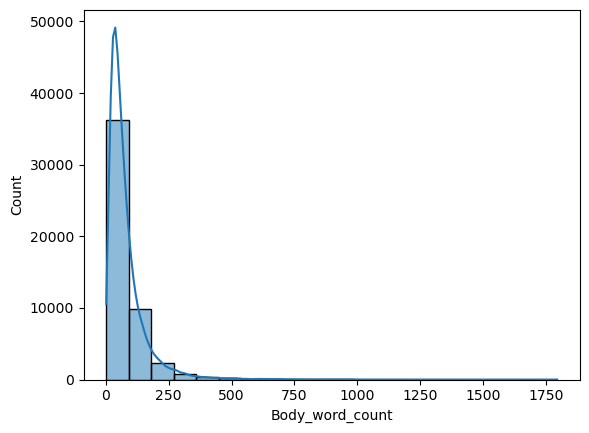

In [48]:

def count_words(text):
    return len(text.split())

# Appliquer la fonction à la colonne 'Body' du jeu de données
df['Body_word_count'] = df['Body'].apply(count_words)

# Calculer la longueur moyenne des questions en nombre de mots
mean_word_count = df['Body_word_count'].mean()

# Nombre de mots et nombre de mots unique dans body
unique_words_count = len(set(' '.join(df['Body']).split()))
total_word_count = df['Body_word_count'].sum() 

print(f"La longueur moyenne des questions en nombre de mots est de {mean_word_count:.2f}.")
print("le nombre total de mots :",total_word_count)
print("The number of unique words in df['Body'] is:", unique_words_count)

sns.histplot(df['Body_word_count'], kde=True, bins=20)



In [49]:
import plotly.express as px

px.box(df['Body_word_count'])

Looking for lines with body size < 3   

In [50]:
df_0_word = df[df['Body_word_count'] < 3]
print("Number of questions with less than 3 words:", df_0_word.shape[0])
display("Number of questions with less than 3 words:", df_0_word)

Number of questions with less than 3 words: 12


'Number of questions with less than 3 words:'

,Title,Body,Tags,Body_word_count
442,what typesafe,typesafe mean,language-agnostic programming-languages comput...,2
1569,why faster php,faster php,php operators comparison-operators equality-op...,2
4045,when i threadlocal variable,threadlocal variable,java multithreading concurrency thread-local t...,2
8852,be way make tradiobutton transparent,delphi,delphi radio-button transparency delphi-2010 t...,1
14646,when mutex semaphore,mutex semaphore,linux multithreading synchronization mutex sem...,2
17832,what metaclasses python,metaclasses,python oop metaclass python-class python-datam...,1
20143,what httphandler aspnet,httphandler aspnet,asp.net httphandler ihttphandler ihttpasynchan...,2
26432,can global constant declare javascript,syntax declaration,javascript variables constants global-variables,2
42908,,multiply javascript,javascript floating-point floating-accuracy,2
43644,what smart pointer i,smart pointer,c++ pointers c++11 smart-pointers c++-faq,2


In [51]:
# Remove the questions with less than 3 words
df = df[df['Body_word_count'] > 2]

error          26497
code           25129
file           24569
work           24097
return         20757
class          20110
run            16344
way            14944
function       14481
string         14271
set            13569
follow         13462
import         13242
user           13234
create         13124
value          13105
problem        13008
method         12627
data           12315
name           11998
make           11836
add            11552
app            11317
know           11291
project        11102
test           11059
id             10950
call           10909
int            10769
application    10760
time           10566
version        10335
also           10304
see            10026
change          9985
object          9970
void            9968
c               9595
type            9509
look            9426
example         9228
view            9147
dont            9064
server          9027
line            9004
could           8880
var             8800
question     

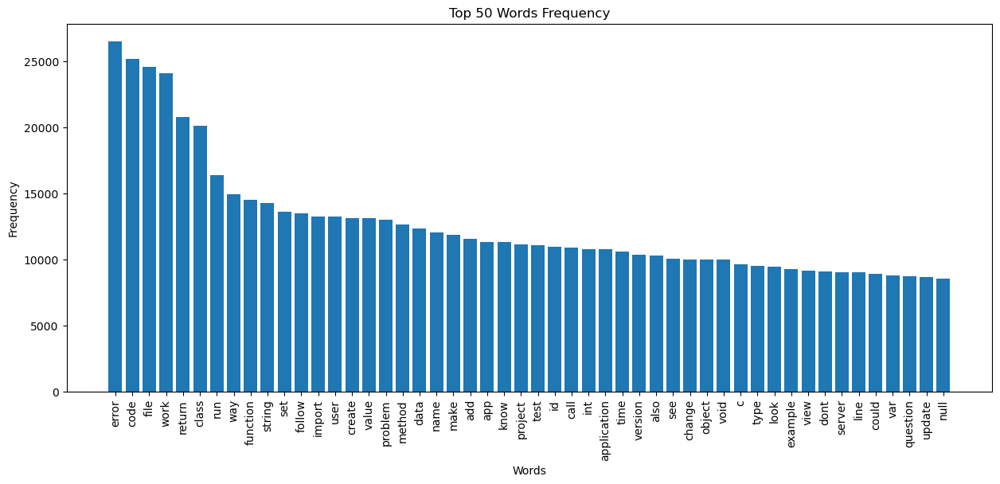

In [52]:
# word frequency
top_50_words = df['Body'].str.split(expand=True).stack().value_counts()[:50]
print(top_50_words)

# Plot the top 50 words frequency
plt.figure(figsize=(15, 6))
plt.bar(top_50_words.index, top_50_words.values)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top 50 Words Frequency')
plt.xticks(rotation=90)
plt.show()


In [53]:
# word frequency
flop_30_words = df['Body'].str.split(expand=True).stack().value_counts()[30:]
print(flop_30_words)


# Plot the top 50 words frequency
'''plt.figure(figsize=(15, 6))
plt.bar(flop_30_words.index, flop_30_words.values)
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('flop 50 Words Frequency')
plt.xticks(rotation=90)
plt.show()'''

time                                                                                 10566
version                                                                              10335
also                                                                                 10304
see                                                                                  10026
change                                                                                9985
                                                                                     ...  
pivottable                                                                               1
checkdetect                                                                              1
vspackage                                                                                1
appitembackgroundcolortransparent                                                        1
orgeclipsejettyservershutdownmonitorshutdownmonitorrunnablerunshutdownmonitorjava        1

"plt.figure(figsize=(15, 6))\nplt.bar(flop_30_words.index, flop_30_words.values)\nplt.xlabel('Words')\nplt.ylabel('Frequency')\nplt.title('flop 50 Words Frequency')\nplt.xticks(rotation=90)\nplt.show()"

In [54]:
#garder un nombre de tags limité, on va garder les 15 tags les plus fréquents, possiblement +, a voir
# eventuellement, garder le smtos les plus frequents.
# topic model  infrence model fda
tags_to_keep = list(pd.Series(tags_frequency).sort_values(ascending=False).iloc[:15].index)
print(tags_to_keep)

['android', 'javascript', 'java', 'c#', 'python', 'ios', 'c++', 'jquery', 'objective-c', 'html', 'php', 'iphone', 'sql-server', 'sql', 'css']


In [55]:
# Supprimer les ligne ou aucun tags ne sont pas dans tags_to_keep
from sklearn.preprocessing import MultiLabelBinarizer
df_tags_filtered = df[df['Tags'].apply(lambda x: any(tag in tags_to_keep for tag in x.split()))]
df_tags_filtered.shape
display(df_tags_filtered.head(), df_tags_filtered.shape)

,Title,Body,Tags,Body_word_count
0,android jetpack navigation bottomnavigationvie...,android jetpack navigation bottomnavigationvie...,android android-architecture-components bottom...,131
1,jetpack compose button drawable,achieve jetpack compose something button eleva...,android android-jetpack-compose android-compos...,60
3,topappbar flash navigate compose navigation,screen scaffold topappbar navigate jetpack nav...,android android-jetpack android-jetpack-compos...,198
4,how create recycler view compose jetpack,special way create recyclerview compose jetpac...,android android-recyclerview android-jetpack-c...,7
6,how navhostfragment,integrate android navigation architecture comp...,android android-fragments android-architecture...,48


(33579, 4)

'mlb = MultiLabelBinarizer(classes=tags_to_keep)\nlabel_tags = pd.DataFrame(mlb.fit_transform(df_tags_filtered[\'Tags\'].apply(lambda x: x.split())), index=df_tags_filtered.index, columns=tags_to_keep)\nlabel_tags.head()\n\n# Concaténer les DataFrames\ndf_tags_filtered = pd.concat([df_tags_filtered[[ "Body", "Title"]], label_tags], axis=1)\ndisplay(df_tags_filtered.head())'

In [56]:

#df_tags_filtered.drop(columns=['Body_word_count'], inplace=True)
display(df_tags_filtered)

df_tags_filtered.to_csv('Data/df_tags_filtered.csv', index=False)

,Title,Body,Tags,Body_word_count
0,android jetpack navigation bottomnavigationvie...,android jetpack navigation bottomnavigationvie...,android android-architecture-components bottom...,131
1,jetpack compose button drawable,achieve jetpack compose something button eleva...,android android-jetpack-compose android-compos...,60
3,topappbar flash navigate compose navigation,screen scaffold topappbar navigate jetpack nav...,android android-jetpack android-jetpack-compos...,198
4,how create recycler view compose jetpack,special way create recyclerview compose jetpac...,android android-recyclerview android-jetpack-c...,7
6,how navhostfragment,integrate android navigation architecture comp...,android android-fragments android-architecture...,48
...,...,...,...,...
49995,spring rest json can handle managedback refere...,post httplocalhosttranslators angularjs fronte...,java json hibernate jackson spring-boot,273
49996,disableenable submit button form fill,form submit button disabledenabled depend form...,javascript forms submit disabled-control,56
49997,how keep net console app run,consider console application start service sep...,c# multithreading sleep manualresetevent,53
49998,how avoid javalangnoclassdeffounderror,code add text exist doc file itll save another...,java apache-poi noclassdeffounderror doc,165


<Axes: >

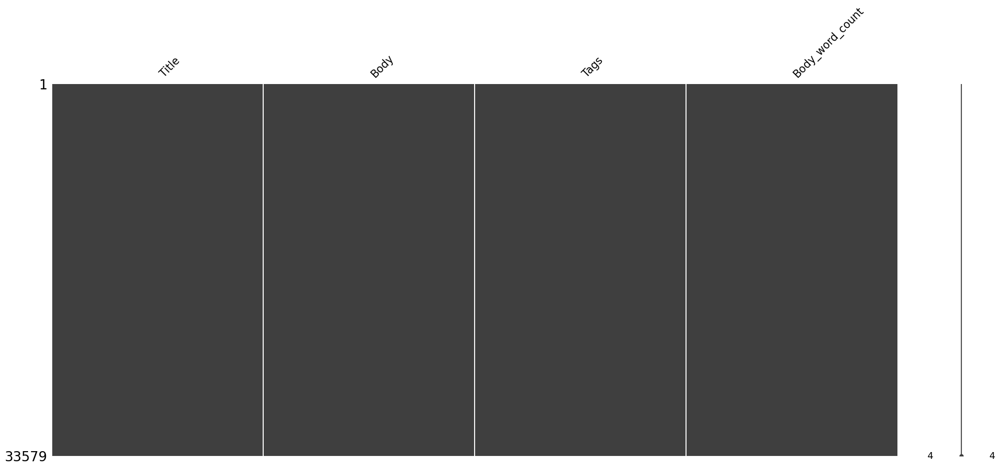

In [57]:
msno.matrix(df_tags_filtered)